In [1]:
import os
import scipy.io
import pandas as pd
import numpy as np
import pydicom

import matplotlib.pyplot as plt
import seaborn as sns
import imageio
from IPython.display import Image

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)


In [2]:
path_raw = '../data/raw'
path_CT = '/FUMPE/CT_scans/'

# CT scans (computed tomography)

"Embolia pulmonar é causada pela obstrução das artérias dos pulmões por coágulos"

https://www.youtube.com/watch?v=OLWn8OoLpBE

Para identificar se o paciente está com embolia o exame mais comum é a tomografia no qual fornece um arquivo dicom


In [3]:
def load_scan_patient(dcm_path):
    
    files = os.listdir(dcm_path)
    files.sort()
    file_dicom = [ pydicom.dcmread(dcm_path +'/'+ str(file)) for file in files]
    
    return file_dicom
    

In [4]:
PAT_001 = load_scan_patient(path_raw+path_CT+'PAT001')

In [5]:
PAT_001[0]

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 208
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: CT Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 1.3.6.1.4.1.9590.100.1.2.5331506912231574009137053520150588438
(0002, 0010) Transfer Syntax UID                 UI: Explicit VR Little Endian
(0002, 0012) Implementation Class UID            UI: 1.3.6.1.4.1.9590.100.1.3.100.9.4
(0002, 0013) Implementation Version Name         SH: 'MATLAB IPT 9.4'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'AXIAL', 'HELICAL']
(0008, 0012) Instance Creation Date              DA: '0'
(0008, 0013) Instance Creation Time              TM: '174444.875'
(0008, 0016) SOP Class UID                       UI: CT Image Storage
(

# Visualização CT e distribuição de pixels

In [6]:
def plot_CT_scan(file):
    fig, ax = plt.subplots(1,2,figsize=(20,5))

    ax[0].set_title("Original CT-scan")
    ax[0].imshow(file, cmap="bone")
    ax[1].set_title("Distribuição de pixels");

    sns.histplot(file.flatten(), ax=ax[1])

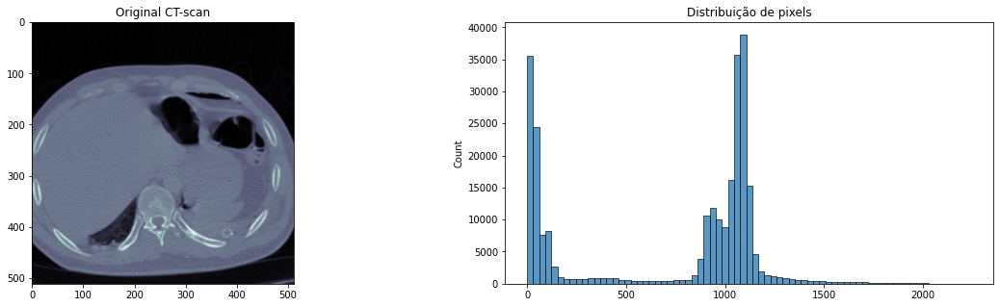

In [7]:
plot_CT_scan(PAT_001[0].pixel_array)

In [8]:
print(PAT_001[0].pixel_array.shape)

(512, 512)


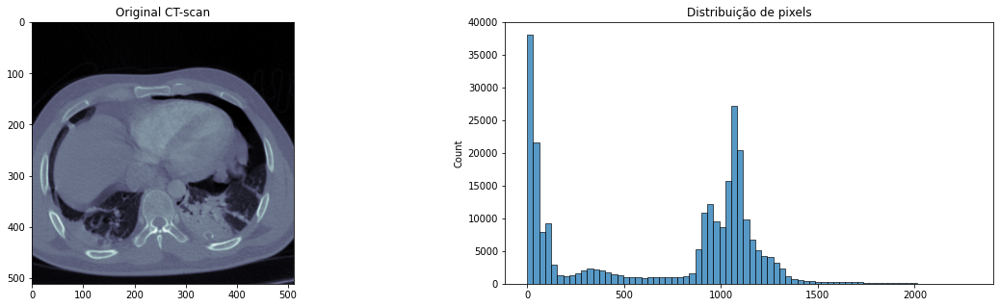

In [9]:
plot_CT_scan(PAT_001[50].pixel_array)

Para visualizar diferentes partes do scan podemos alterar essa janela de pixels. Podemos ver diferentes materias através da Hounsfield scale

https://en.wikipedia.org/wiki/Hounsfield_scale

Para diferentes tomografias ajustamos os valores de width and level values.

https://radiopaedia.org/articles/windowing-ct

No nosso caso já temos os valores a serem aplicados para conseguir visualizar a imagem, exemplo scan 1 paciente 1


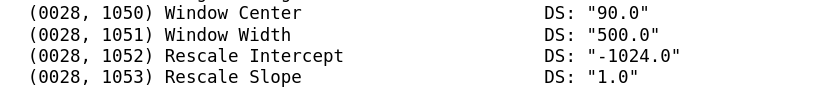

In [10]:
def change_pixels(img, window_center, window_width, intercept, slope ):
    
    img = (img*slope +intercept)
    
    img_min = window_center - (window_width)/2
    img_max = window_center + (window_width)/2
    
    img[img<img_min] = img_min 
    img[img>img_max] = img_max
    
    img = (img - img_min) / (img_max - img_min)*255.0 
    img = (img*slope +intercept)
    return img

In [11]:
def get_paramas_HU(dicom):
    return [ int(dicom[('0028','1050')].value),
             int(dicom[('0028','1051')].value), 
             int(dicom[('0028','1052')].value), 
             int(dicom[('0028','1053')].value) ] 

In [12]:
window_center , window_width, intercept, slope = get_paramas_HU(PAT_001[0])
image_pat1 = PAT_001[0].pixel_array

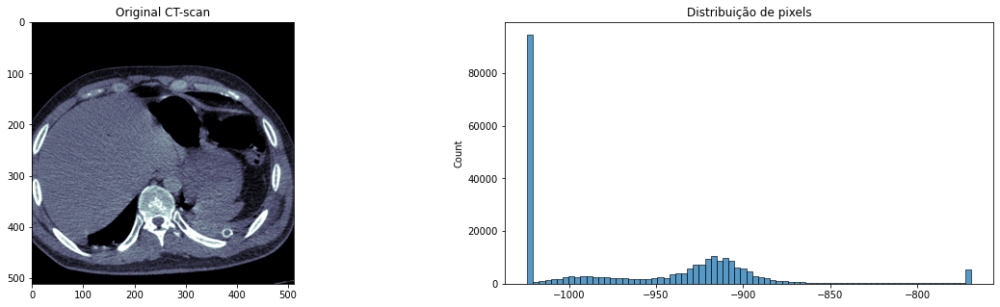

In [13]:
image = change_pixels(image_pat1, window_center, window_width, intercept, slope)
plot_CT_scan(image)

In [14]:
window_center , window_width, intercept, slope = get_paramas_HU(PAT_001[0])
image_pat1 = PAT_001[50].pixel_array

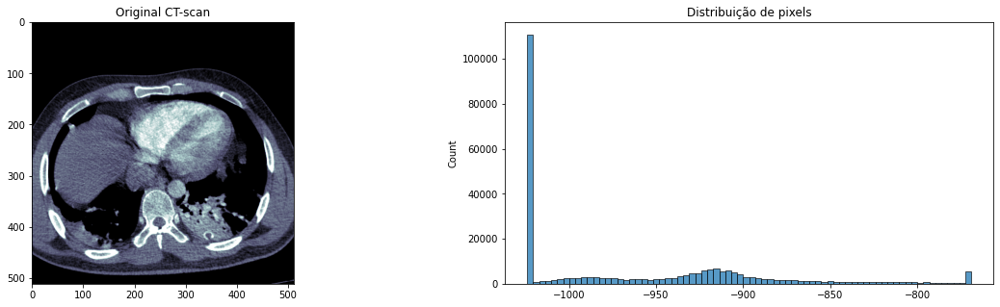

In [15]:
image = change_pixels(image_pat1, window_center, window_width, intercept, slope)
plot_CT_scan(image)

É possivel alterar alguns valores para ver o comportamento da imagem, mas em geral é melhor utilizar os parametros fornecidos.

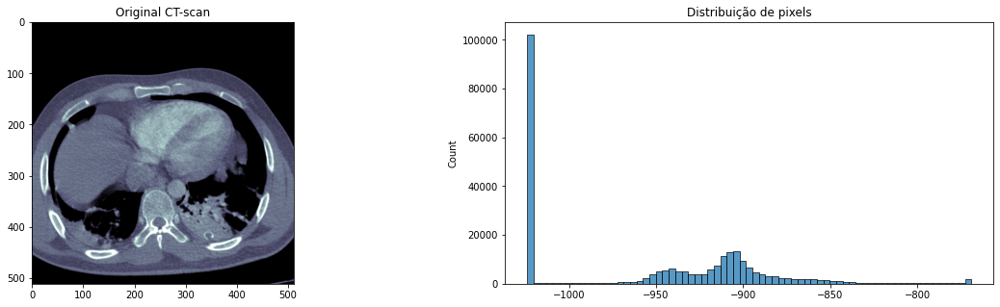

In [16]:
image = change_pixels(image_pat1, window_center, 1000, intercept, slope)
plot_CT_scan(image)

# Visualization Gif

Vamos visualizar agora em uma gif juntando todas as imagens

In [17]:
def image_transform_hu(ct_information):
    
    window_center , window_width, intercept, slope = get_paramas_HU(ct_information)
    image_pixel = ct_information.pixel_array
    image = change_pixels(image_pixel, window_center, window_width, intercept, slope)
    
    return image

In [18]:
def ct_pixels(patient_ct):
    
    images = np.stack([ image_transform_hu(file) for file in patient_ct])
    
    return images

In [19]:
images = ct_pixels(PAT_001)

In [20]:
imageio.mimsave("../references/patiente1.gif", images, duration=0.2)

Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 pr

Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 pr

Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 pr

Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [-1024.0, -769.0]. Convert image to uint8 pr

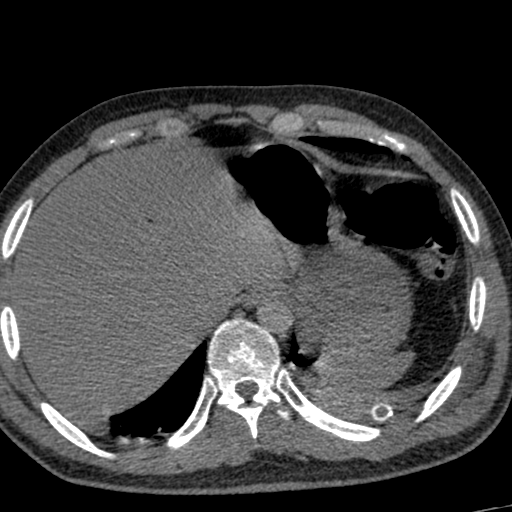

In [21]:
Image(open('../references/patiente1.gif','rb').read())